## UpConvs for Image Generation

Opposite of multi-class classification. In multi-class classification, we take an image as input, and output a label.

Train a network that **takes in a label as input, and outputs an image**.

<img src="https://miro.medium.com/max/700/1*wy3oRM8jh8LKF6Iku2Uh4w.png" width=700px/>

<img src="https://blog.paperspace.com/content/images/2020/07/conv.gif" height=285px/>


## TensorBoard Setup

Embedded tensorboard

In [ ]:
import torch.utils.tensorboard as tb
log_dir = 'log'
!rm -rf {log_dir}

%load_ext tensorboard
%tensorboard --logdir {log_dir} --reload_interval 1

<IPython.core.display.Javascript object>

## Data Preparation

Here we'll use a custom dataset of the faces.

In [ ]:
!rm -f images.zip
!rm -rf images/
!wget 'https://docs.google.com/uc?export=download&id=1WGlFWjVJ3Vwu6_mMUkaWzVnuhzUc_nkI' -O images.zip
!unzip images.zip

--2024-06-24 19:11:18--  https://docs.google.com/uc?export=download&id=1WGlFWjVJ3Vwu6_mMUkaWzVnuhzUc_nkI
Resolving docs.google.com (docs.google.com)... 142.251.12.113, 142.251.12.138, 142.251.12.100, ...
Connecting to docs.google.com (docs.google.com)|142.251.12.113|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://drive.usercontent.google.com/download?id=1WGlFWjVJ3Vwu6_mMUkaWzVnuhzUc_nkI&export=download [following]
--2024-06-24 19:11:20--  https://drive.usercontent.google.com/download?id=1WGlFWjVJ3Vwu6_mMUkaWzVnuhzUc_nkI&export=download
Resolving drive.usercontent.google.com (drive.usercontent.google.com)... 74.125.200.132, 2404:6800:4003:c00::84
Connecting to drive.usercontent.google.com (drive.usercontent.google.com)|74.125.200.132|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 175598 (171K) [application/octet-stream]
Saving to: ‘images.zip’

images.zip          100%[===================>] 171.48K  --.-KB/s    in 0.0

## Dataset

Currently, the dataset yields pairs of (image, label), where label is an int (image id). Since our network will take the label as input, it's common practice to transform the label into a **one-hot vector**.

If we have a total of $n$ labels, the one-hot representation of a label $l$ is a $n$-dimensional vector $x$, where $x_i$ = 1 if $i = l$, and $0$ otherwise.

### One-hot example  
if we have 5 labels, the one hot representation of the label 0 is `[1, 0, 0, 0, 0]`, the one hot representation of the label 1 is `[0, 1, 0, 0, 0]`, ...

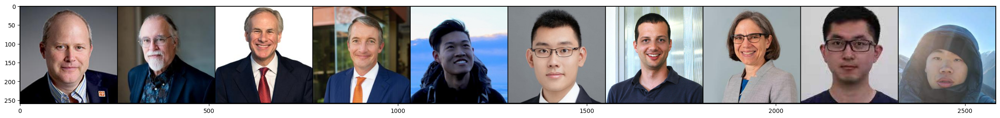

In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt
import pathlib
from PIL import Image

import torch
import torch.nn as nn
import torchvision

to_tensor = torchvision.transforms.ToTensor()
images = torch.stack([to_tensor(Image.open(p)) for p in sorted(pathlib.Path('images').glob('*.jpg'))])
labels = torch.eye(images.shape[0])

vis = torchvision.utils.make_grid(images, nrow=10)

plt.figure(figsize=(30, 3))
plt.imshow(vis.permute(1, 2, 0))
plt.show()


## Model Implementation and Training



In [ ]:
import time
import numpy as np
from tqdm.notebook import tqdm
torch.cuda.empty_cache()

class UpNetwork(nn.Module):
    def __init__(self, input_channels, output_channels):
        super().__init__()
        self.layers = torch.nn.Sequential(
            nn.ConvTranspose2d(input_channels, 64, 16),
            nn.PReLU(),
            nn.ConvTranspose2d(64, 10, 16, 16),
            nn.PReLU(),
            nn.Upsample((262, 262), mode='bilinear'),
            nn.Conv2d(10, 3, 7),
            nn.Sigmoid(),
        )

    def forward(self, x):
        """
        Translate one-hot vector to image.
        Image ranges from [0 .. 1].

        Input:
            x (float tensor N x 10): input id encoded as a one-hot vector
        Output:
            y (float tensor N x 3 x 256 x 256): image corresponding to each id
        """
        x = x.view(x.shape + (1, 1)).float()
        x = self.layers(x)
        return x

    def check_num_parameters(self):
      return sum([np.prod(param.shape) for param in self.parameters()])


def model_quality(model):
    return float(-(torch.sum((model(labels)-images)**2) / torch.sum((0.5-images)**2)+np.exp(-10)).log())

def size_penalty(model):
    return 10 * model.check_num_parameters() / np.prod(images.shape)


def train(model, device, lr=1e-2, iterations=10000):
    # Setting up the tensorboard logger
    logger = tb.SummaryWriter(log_dir + '/{}'.format(time.strftime('%H-%M-%S')), flush_secs=1)

    # TODO: What loss should we use?
    loss_function = nn.HuberLoss()

    # If we're trying to overfit, what should we set weight_decay to?
    optimizer = torch.optim.AdamW(model.parameters(), lr=lr)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, 500)

    # Set the model to training mode
    model.train()

    print('size_penalty =', size_penalty(model))

    # Wrap in a progress bar.
    for global_step in tqdm(range(iterations)):
        images_pred = model(labels)

        # Compute loss and update model weights.
        loss = loss_function(images_pred, images)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        scheduler.step()

        # Add loss to TensorBoard.
        if global_step % 10 == 0:
            logger.add_scalar('loss', loss.item(), global_step=global_step)
            logger.add_scalar('quality', model_quality(model), global_step=global_step)
            logger.add_scalar('score', (model_quality(model)-size_penalty(model)), global_step=global_step)


        if global_step % 100 == 0:
            image_grid = (torchvision.utils.make_grid(images_pred, nrow=10) * 255).byte()
            logger.add_image('image_pred', image_grid, global_step=global_step)


    model.eval()
    print('model_quality   = ', model_quality(model))
    print('score           = ', model_quality(model)-size_penalty(model))

# Actually train the model here!
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model = UpNetwork(10, 3)
model.to(device)
images = images.to(device)
labels = labels.to(device)

train(model, device)

size_penalty = 1.6745452880859375


  0%|          | 0/10000 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,
/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass


model_quality   =  7.216986179351807
score           =  5.542440891265869


## Model Evaluation and Visualization

Let's see how the image generation model works

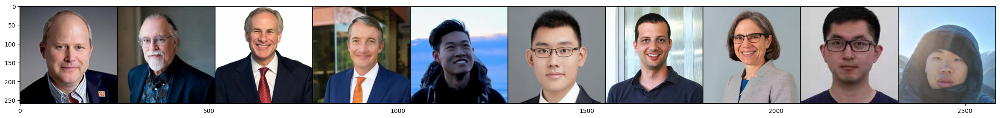

In [ ]:
model.eval()
model = model.cpu()
image_pred = model(torch.eye(10))

vis = torchvision.utils.make_grid(image_pred, nrow=10)

plt.figure(figsize=(30, 3))
plt.imshow(vis.permute(1, 2, 0).detach().numpy())
plt.show()

In [ ]:
import bz2
import pickle

@torch.no_grad()
def grader_eval(model):
    model.eval()
    model = model.to(device)
    return model_quality(model)-size_penalty(model)

z = bz2.BZ2Compressor()
z.compress(pickle.dumps(grader_eval(model))) + z.flush()

b"BZh91AY&SY\xee\xb0\xe0?\x00\x00'\xff\xf0\xff@\x03\x00\x00I\x00DH\x19\x10\x00?'\xde A\xe4\x0e\x00@\x00\x00\x00\xa0\x00hD\x08\x00\x03@\xd3F\x80h\x0055\x13\x19F\x98L\x9e\xa1\x93\x01\x1bQ\xb57\xa2\x88\x1bc\x17\xc19:\x02\x11e\x11\xc7'\x8b\xddE\xc2\x13\xde\x98\x02\xa2\x03BT\xd8\xece\xa5\x06]\x9e\xf1\xaa\xd0\x9c\x957o\x82]\x944\xa7\xea\xde\x96\x8a\xa9%Q\xd4\xdd\x03\x08\x02!\xb8k\x9d\xc8\xcd\xfd\xc8\x99\xe1\xcb0\x87\x8f\xe2\xeeH\xa7\n\x12\x1d\xd6\x1c\x07\xe0"